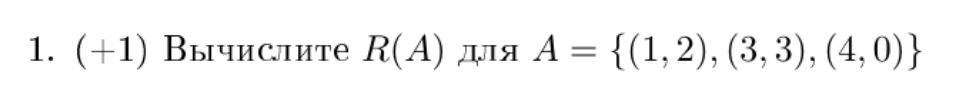

In [47]:
from itertools import product
import numpy as np

data = np.array([[1, 2], [3, 3], [4, 0]])
M = data[0].shape[0]
sigmas = np.array(list(product([-1, 1], repeat=M)))
radamacher_complexity = 0
for s in sigmas:
    tmp = []
    for d in data:
        tmp.append(d @ s)
    radamacher_complexity += np.max(tmp)
radamacher_complexity = radamacher_complexity / M / sigmas.shape[0]
radamacher_complexity

1.0

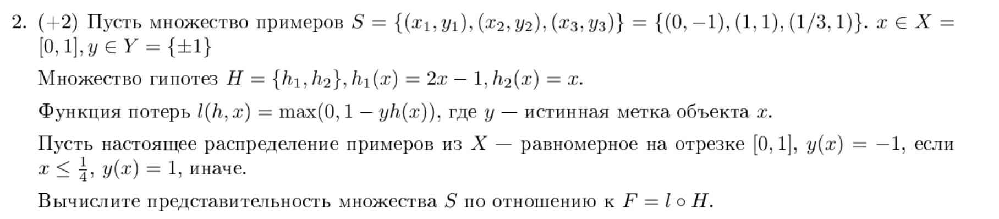

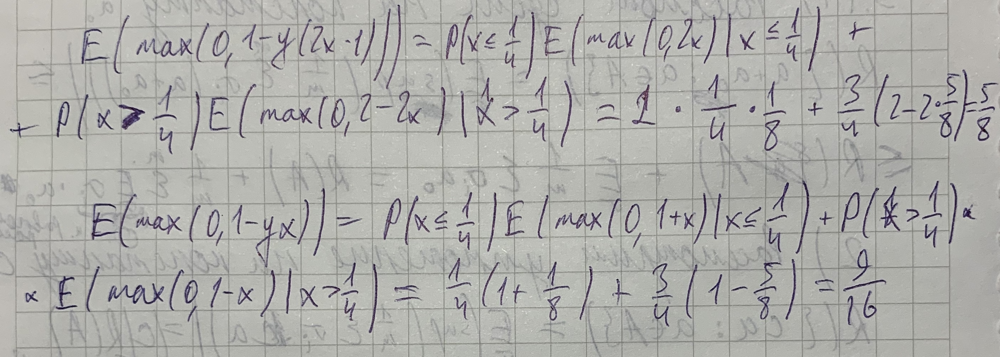

In [45]:
data = np.array([[0, -1], [1, 1], [1/3, 1]])
H = [lambda x: 2*x - 1, lambda x: x]
def true(x):
    return -1 if x < 1/4 else 1
l = lambda h, x: max(0, 1 - true(x) * h(x))
LDs = [5/8, 9/16]
def Ls(f):
    return np.sum([f(d[0]) for d in data]) / data.shape[0]

tmp = []
for h, ld in zip(H, LDs):
    ls = Ls(lambda x: l(h, x))
    tmp.append(ld - ls)
print("RepD(F, S) = ", np.max(tmp))

RepD(F, S) =  0.18055555555555552


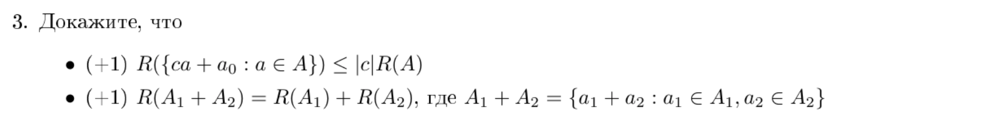

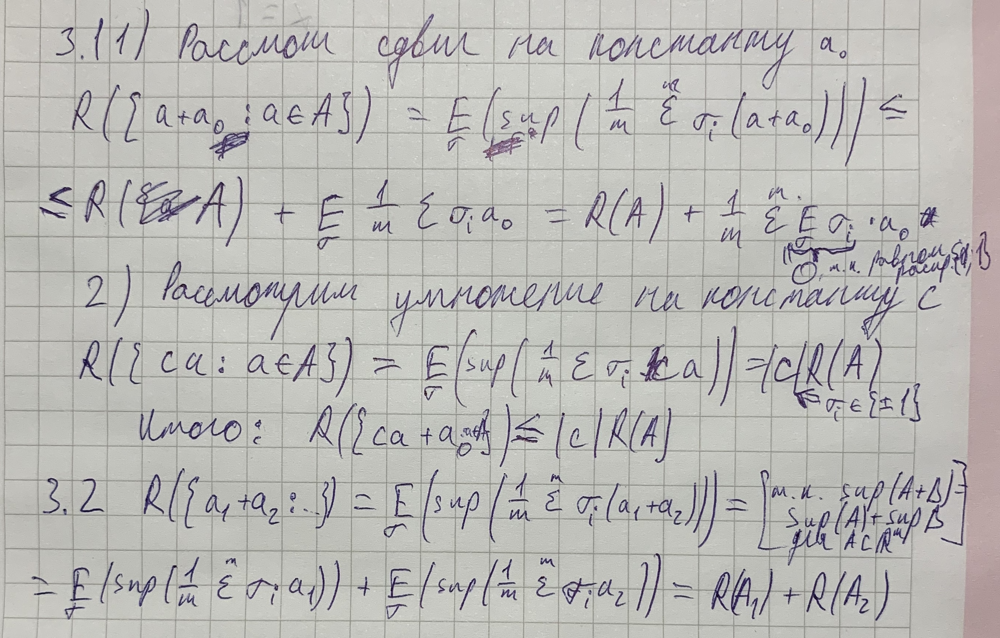

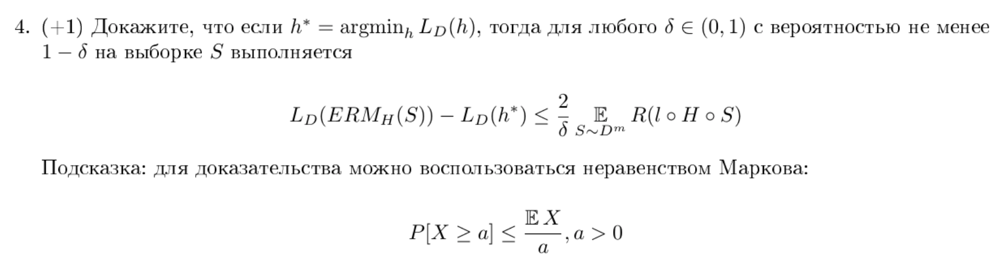

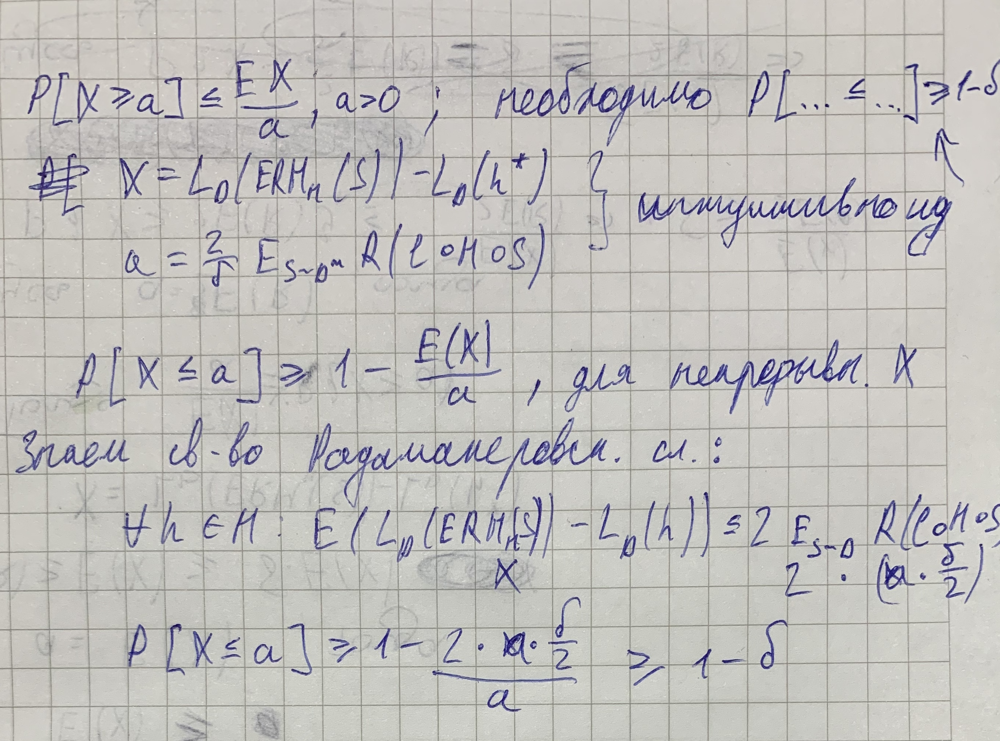
P.S. Если a == 0, то классификатор верно классифицирует все объекты выборки (для нулевой Радемахеровской сложности требуется, чтобы все f(z) были равны 0), а значит исходное множество разделяемо и доказываемое выражение всегда верно